# Temperature Forecast 

### Problem Statement:     

Data Set Information:

This data is for the purpose of bias correction of next-day maximum and minimum air temperatures forecast of the LDAPS model operated by the Korea Meteorological Administration over Seoul, South Korea. This data consists of summer data from 2013 to 2017. The input data is largely composed of the LDAPS model's next-day forecast data, in-situ maximum and minimum temperatures of present-day, and geographic auxiliary variables. There are two outputs (i.e. next-day maximum and minimum air temperatures) in this data. Hindcast validation was conducted for the period from 2015 to 2017.

Attribute Information:

For more information, read [Cho et al, 2020].
1. station - used weather station number: 1 to 25
2. Date - Present day: yyyy-mm-dd ('2013-06-30' to '2017-08-30')
3. Present_Tmax - Maximum air temperature between 0 and 21 h on the present day (Â°C): 20 to 37.6
4. Present_Tmin - Minimum air temperature between 0 and 21 h on the present day (Â°C): 11.3 to 29.9
5. LDAPS_RHmin - LDAPS model forecast of next-day minimum relative humidity (%): 19.8 to 98.5
6. LDAPS_RHmax - LDAPS model forecast of next-day maximum relative humidity (%): 58.9 to 100
7. LDAPS_Tmax_lapse - LDAPS model forecast of next-day maximum air temperature applied lapse rate (Â°C): 17.6 to 38.5
8. LDAPS_Tmin_lapse - LDAPS model forecast of next-day minimum air temperature applied lapse rate (Â°C): 14.3 to 29.6
9. LDAPS_WS - LDAPS model forecast of next-day average wind speed (m/s): 2.9 to 21.9
10. LDAPS_LH - LDAPS model forecast of next-day average latent heat flux (W/m2): -13.6 to 213.4
11. LDAPS_CC1 - LDAPS model forecast of next-day 1st 6-hour split average cloud cover (0-5 h) (%): 0 to 0.97
12. LDAPS_CC2 - LDAPS model forecast of next-day 2nd 6-hour split average cloud cover (6-11 h) (%): 0 to 0.97
13. LDAPS_CC3 - LDAPS model forecast of next-day 3rd 6-hour split average cloud cover (12-17 h) (%): 0 to 0.98
14. LDAPS_CC4 - LDAPS model forecast of next-day 4th 6-hour split average cloud cover (18-23 h) (%): 0 to 0.97
15. LDAPS_PPT1 - LDAPS model forecast of next-day 1st 6-hour split average precipitation (0-5 h) (%): 0 to 23.7
16. LDAPS_PPT2 - LDAPS model forecast of next-day 2nd 6-hour split average precipitation (6-11 h) (%): 0 to 21.6
17. LDAPS_PPT3 - LDAPS model forecast of next-day 3rd 6-hour split average precipitation (12-17 h) (%): 0 to 15.8
18. LDAPS_PPT4 - LDAPS model forecast of next-day 4th 6-hour split average precipitation (18-23 h) (%): 0 to 16.7
19. lat - Latitude (Â°): 37.456 to 37.645
20. lon - Longitude (Â°): 126.826 to 127.135
21. DEM - Elevation (m): 12.4 to 212.3
22. Slope - Slope (Â°): 0.1 to 5.2
23. Solar radiation - Daily incoming solar radiation (wh/m2): 4329.5 to 5992.9
24. Next_Tmax - The next-day maximum air temperature (Â°C): 17.4 to 38.9
25. Next_Tmin - The next-day minimum air temperature (Â°C): 11.3 to 29.8T

Please note that there are two target variables here: 

1) Next_Tmax: Next day maximum temperature

2) Next_Tmin: Next day  minimum temperature



## Importing  libraries.

In [209]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stat
from scipy.stats import zscore
from sklearn.linear_model import LinearRegression
from sklearn.naive_bayes import MultinomialNB,GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier,RandomForestRegressor
from sklearn.ensemble import AdaBoostClassifier
from sklearn.preprocessing import LabelEncoder
import xgboost
from xgboost import XGBRegressor
from sklearn.metrics import accuracy_score,classification_report,confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.metrics import roc_curve,roc_auc_score
from sklearn.metrics import r2_score,mean_squared_error,mean_absolute_error
import joblib
import warnings
warnings.filterwarnings('ignore')
pd.set_option('display.max_rows', None) # to see all the rows
pd.set_option('display.max_columns', None) # to see all the columns

## Importing and Exploring dataset

In [210]:
TF=pd.read_csv('temp_forecast.csv')
TF.head()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,0.0,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,0.159444,0.127727,0.0,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,0.204091,0.142125,0.0,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,0.161157,0.134249,0.0,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,0.178892,0.170021,0.0,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5


In [211]:
TF.shape

(7752, 25)

Dataset has 7752 rows and 25 columns

In [212]:
TF.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7752 entries, 0 to 7751
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   station           7750 non-null   float64
 1   Date              7750 non-null   object 
 2   Present_Tmax      7682 non-null   float64
 3   Present_Tmin      7682 non-null   float64
 4   LDAPS_RHmin       7677 non-null   float64
 5   LDAPS_RHmax       7677 non-null   float64
 6   LDAPS_Tmax_lapse  7677 non-null   float64
 7   LDAPS_Tmin_lapse  7677 non-null   float64
 8   LDAPS_WS          7677 non-null   float64
 9   LDAPS_LH          7677 non-null   float64
 10  LDAPS_CC1         7677 non-null   float64
 11  LDAPS_CC2         7677 non-null   float64
 12  LDAPS_CC3         7677 non-null   float64
 13  LDAPS_CC4         7677 non-null   float64
 14  LDAPS_PPT1        7677 non-null   float64
 15  LDAPS_PPT2        7677 non-null   float64
 16  LDAPS_PPT3        7677 non-null   float64


All columns in dataset are float type and only date column is object type.

In [213]:
TF.describe()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
count,7750.000000,7682.000000,7682.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7725.000000,7725.000000
mean,13.000000,29.768211,23.225059,56.759372,88.374804,29.613447,23.512589,7.097875,62.505019,0.368774,0.356080,0.318404,0.299191,0.591995,0.485003,0.278200,0.269407,37.544722,126.991397,61.867972,1.257048,5341.502803,30.274887,22.932220
std,7.211568,2.969999,2.413961,14.668111,7.192004,2.947191,2.345347,2.183836,33.730589,0.262458,0.258061,0.250362,0.254348,1.945768,1.762807,1.161809,1.206214,0.050352,0.079435,54.279780,1.370444,429.158867,3.128010,2.487613
min,1.000000,20.000000,11.300000,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,37.456200,126.826000,12.370000,0.098475,4329.520508,17.400000,11.300000
25%,7.000000,27.800000,21.700000,45.963543,84.222862,27.673499,22.089739,5.678705,37.266753,0.146654,0.140615,0.101388,0.081532,0.000000,0.000000,0.000000,0.000000,37.510200,126.937000,28.700000,0.271300,4999.018555,28.200000,21.300000
50%,13.000000,29.900000,23.400000,55.039024,89.793480,29.703426,23.760199,6.547470,56.865482,0.315697,0.312421,0.262555,0.227664,0.000000,0.000000,0.000000,0.000000,37.550700,126.995000,45.716000,0.618000,5436.345215,30.500000,23.100000
75%,19.000000,32.000000,24.900000,67.190056,93.743629,31.710450,25.152909,8.032276,84.223616,0.575489,0.558694,0.496703,0.499489,0.052525,0.018364,0.007896,0.000041,37.577600,127.042000,59.832400,1.767800,5728.316406,32.600000,24.600000
max,25.000000,37.600000,29.900000,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,0.967277,0.968353,0.983789,0.974710,23.701544,21.621661,15.841235,16.655469,37.645000,127.135000,212.335000,5.178230,5992.895996,38.900000,29.800000


In [214]:
TF.isnull().sum()

station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
dtype: int64

#### As number of missing values in columns are less then 1% of number of rows we can treat missing values before outlier analysis

In [215]:
TF[TF.station.isna()]

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,37.4562,126.826,12.370,0.098475,4329.520508,17.4,11.3
7751,NaN,NaN,37.6,29.9,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,0.967277,0.968353,0.983789,0.97471,23.701544,21.621661,15.841235,16.655469,37.6450,127.135,212.335,5.178230,5992.895996,38.9,29.8


In [216]:
TF.station.fillna(1,inplace=True)

In [217]:
TF['Date']=TF['Date'].fillna(TF['Date'].mode()[0])

In [218]:
TF.tail(4)

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
7748,24.0,30-08-2017,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,0.035874,0.074962,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,30-08-2017,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,0.048954,0.059869,0.000000,0.000796,0.000000,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,1.0,01-07-2013,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3
7751,1.0,01-07-2013,37.6,29.9,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,0.967277,0.968353,0.983789,0.974710,23.701544,21.621661,15.841235,16.655469,37.6450,127.135,212.3350,5.178230,5992.895996,38.9,29.8


NaN values in station and Date columns are corrected.

In [219]:
col=TF.columns.drop('Date')
col

Index(['station', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin', 'LDAPS_RHmax',
       'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS', 'LDAPS_LH',
       'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4', 'LDAPS_PPT1',
       'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon', 'DEM', 'Slope',
       'Solar radiation', 'Next_Tmax', 'Next_Tmin'],
      dtype='object')

In [220]:
for i in col:
    TF[i].fillna(TF[i].mean(),inplace=True)
TF.isnull().sum()

station             0
Date                0
Present_Tmax        0
Present_Tmin        0
LDAPS_RHmin         0
LDAPS_RHmax         0
LDAPS_Tmax_lapse    0
LDAPS_Tmin_lapse    0
LDAPS_WS            0
LDAPS_LH            0
LDAPS_CC1           0
LDAPS_CC2           0
LDAPS_CC3           0
LDAPS_CC4           0
LDAPS_PPT1          0
LDAPS_PPT2          0
LDAPS_PPT3          0
LDAPS_PPT4          0
lat                 0
lon                 0
DEM                 0
Slope               0
Solar radiation     0
Next_Tmax           0
Next_Tmin           0
dtype: int64

#### All the missing values are treated.

#### Will extract month and year from the date column.

In [221]:
# get month from the corresponding 
#  Date column value
#TF['Month'] = pd.DatetimeIndex(TF['Date']).month

In [222]:
# get month from the corresponding 
#  Date column value
TF['Year'] = pd.DatetimeIndex(TF['Date']).year

In [223]:
#Drop column DAte from dataset as we have collected the required data.

TF.drop('Date',inplace=True,axis=1)

In [224]:
# convert station column to object data type as it is unordered categoey
TF.station=TF.station.astype('object')
TF.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7752 entries, 0 to 7751
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   station           7752 non-null   object 
 1   Present_Tmax      7752 non-null   float64
 2   Present_Tmin      7752 non-null   float64
 3   LDAPS_RHmin       7752 non-null   float64
 4   LDAPS_RHmax       7752 non-null   float64
 5   LDAPS_Tmax_lapse  7752 non-null   float64
 6   LDAPS_Tmin_lapse  7752 non-null   float64
 7   LDAPS_WS          7752 non-null   float64
 8   LDAPS_LH          7752 non-null   float64
 9   LDAPS_CC1         7752 non-null   float64
 10  LDAPS_CC2         7752 non-null   float64
 11  LDAPS_CC3         7752 non-null   float64
 12  LDAPS_CC4         7752 non-null   float64
 13  LDAPS_PPT1        7752 non-null   float64
 14  LDAPS_PPT2        7752 non-null   float64
 15  LDAPS_PPT3        7752 non-null   float64
 16  LDAPS_PPT4        7752 non-null   float64


In [225]:
TF.head()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Year
0,1,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,0.0,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2,2013
1,2,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,0.159444,0.127727,0.0,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5,2013
2,3,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,0.204091,0.142125,0.0,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9,2013
3,4,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,0.161157,0.134249,0.0,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3,2013
4,5,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,0.178892,0.170021,0.0,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5,2013


## Exploratory Data Analysis

### Univariate Analysis

In [226]:
# store numerical columns on col
col=TF.columns.drop('station')
col

Index(['Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin', 'LDAPS_RHmax',
       'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS', 'LDAPS_LH',
       'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4', 'LDAPS_PPT1',
       'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon', 'DEM', 'Slope',
       'Solar radiation', 'Next_Tmax', 'Next_Tmin', 'Year'],
      dtype='object')

In [227]:
col=col.drop(['Next_Tmax','Next_Tmin'])
col

Index(['Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin', 'LDAPS_RHmax',
       'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS', 'LDAPS_LH',
       'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4', 'LDAPS_PPT1',
       'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon', 'DEM', 'Slope',
       'Solar radiation', 'Year'],
      dtype='object')

Violin Plot forPresent_Tmax


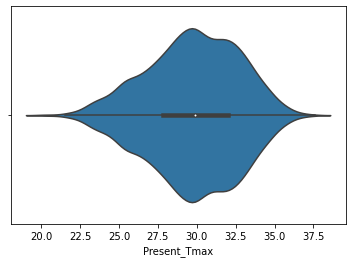

Violin Plot forPresent_Tmin


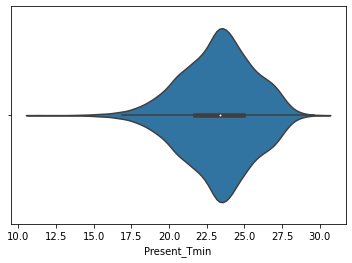

Violin Plot forLDAPS_RHmin


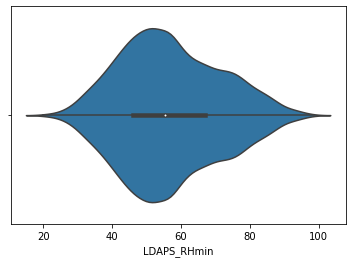

Violin Plot forLDAPS_RHmax


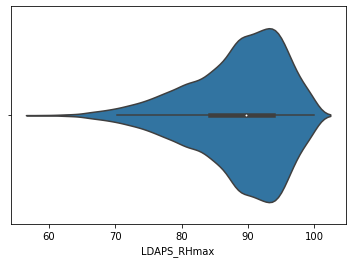

Violin Plot forLDAPS_Tmax_lapse


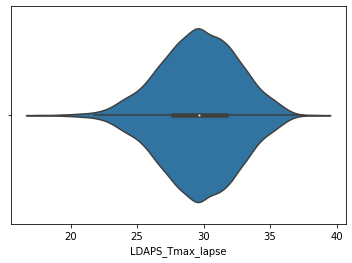

Violin Plot forLDAPS_Tmin_lapse


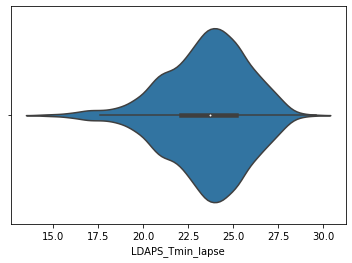

Violin Plot forLDAPS_WS


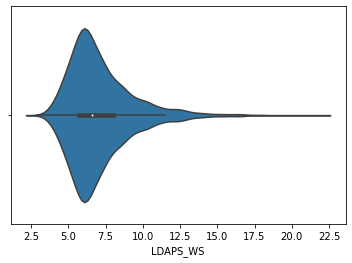

Violin Plot forLDAPS_LH


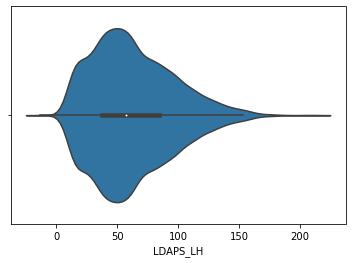

Violin Plot forLDAPS_CC1


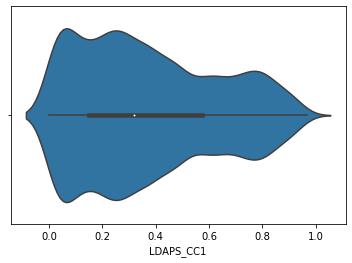

Violin Plot forLDAPS_CC2


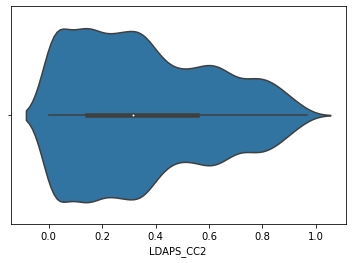

Violin Plot forLDAPS_CC3


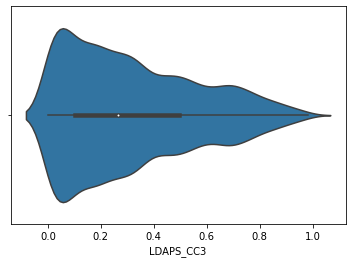

Violin Plot forLDAPS_CC4


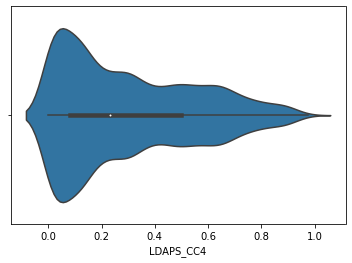

Violin Plot forLDAPS_PPT1


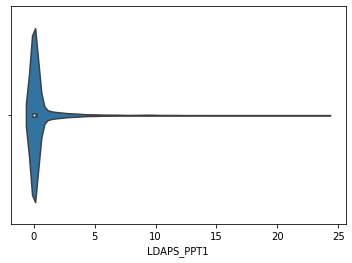

Violin Plot forLDAPS_PPT2


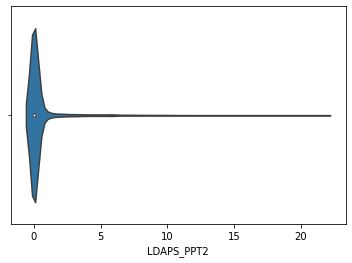

Violin Plot forLDAPS_PPT3


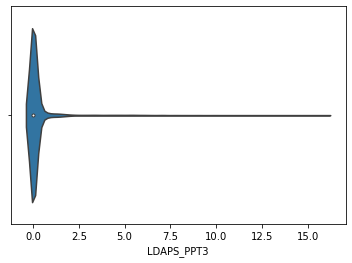

Violin Plot forLDAPS_PPT4


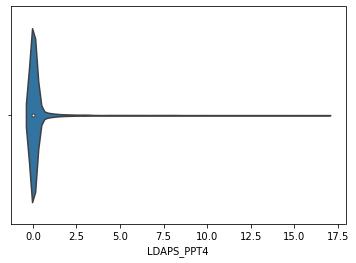

Violin Plot forlat


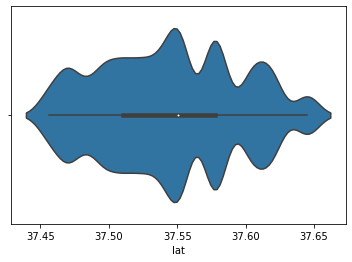

Violin Plot forlon


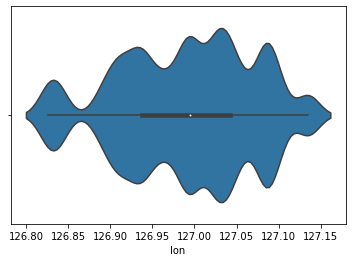

Violin Plot forDEM


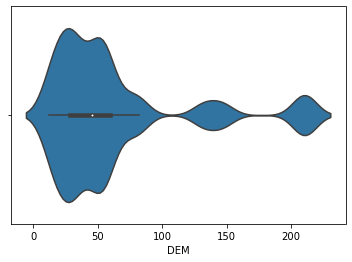

Violin Plot forSlope


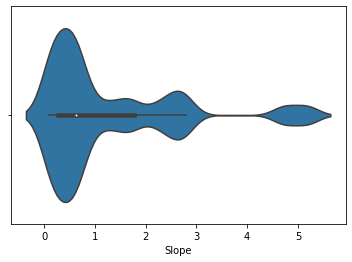

Violin Plot forSolar radiation


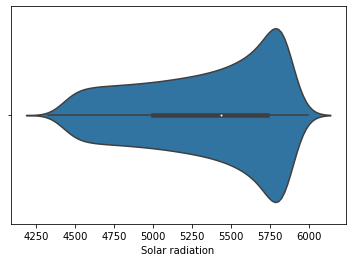

Violin Plot forYear


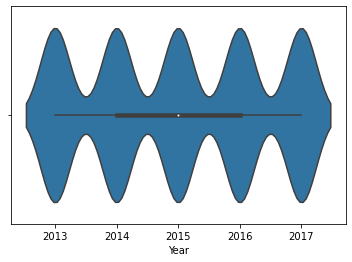

In [228]:
# Plot Violin plot for all the numerical columns
for i in col:
    sns.violinplot(TF[i])
    print('Violin Plot for'+i)
    plt.show()

Observation:
    
Present_Tmax :  Present_Tmax is rangling majorly from 25 to 35.
    
Present_Tmin : THis column is ranging majorly from 20 to 27.5.
    
LDAPS_RHmin : LDAPS_RHmin ranges highly from 40 to 80.
    
LDAPS_RHmax : RHmax is from 80 to 100. 
    
LDAPS_Tmax : LDAPS_Tmax ranges from 25 to 35 in more number.
    
LDAPS_Tmin_lapse : This column ranges from 20 to 27.5.
    
LDAPS_WS : LDAPS_WS ranges majorly form 5 to 7.5.
    
LDAPS_LH : This column is at peak for 50.
    
LDAPS_CC1 : This ranges from 0 to 1 and is unformly distributed.
    
LDAPS_CC2 : This ranges from 0 to 1 and is unformly distributed. 
    
LDAPS_CC3 : This ranges from 0 to 1 and is unformly distributed.
    
Solar Radiation : Most of stations have solar radiation around 5750 and reduces to 6000.    

Box Plot forPresent_Tmax


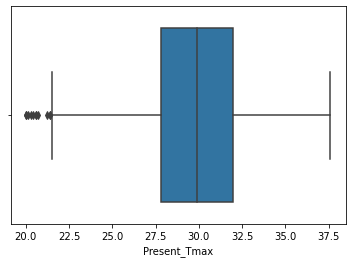

Box Plot forPresent_Tmin


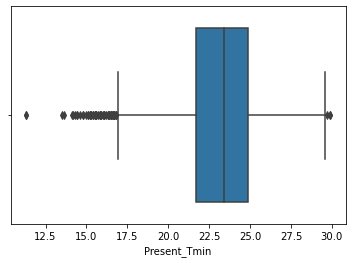

Box Plot forLDAPS_RHmin


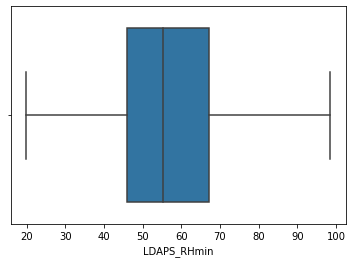

Box Plot forLDAPS_RHmax


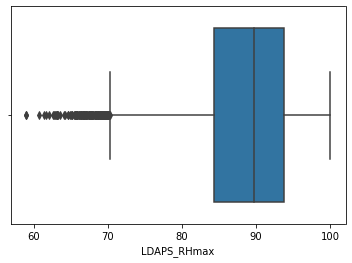

Box Plot forLDAPS_Tmax_lapse


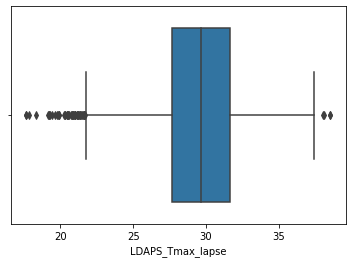

Box Plot forLDAPS_Tmin_lapse


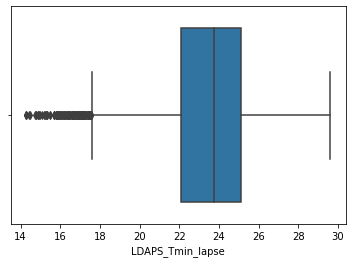

Box Plot forLDAPS_WS


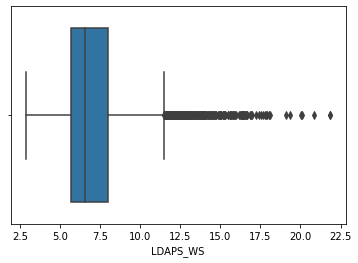

Box Plot forLDAPS_LH


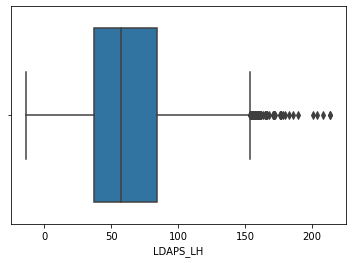

Box Plot forLDAPS_CC1


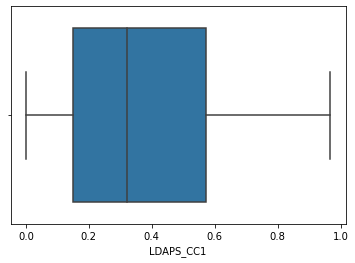

Box Plot forLDAPS_CC2


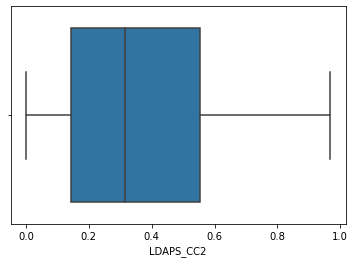

Box Plot forLDAPS_CC3


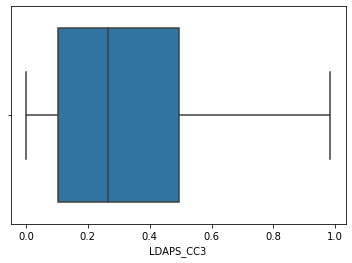

Box Plot forLDAPS_CC4


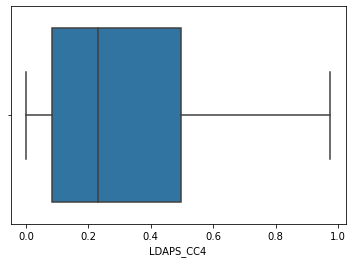

Box Plot forLDAPS_PPT1


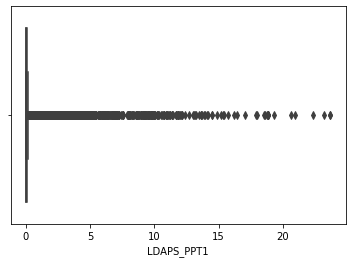

Box Plot forLDAPS_PPT2


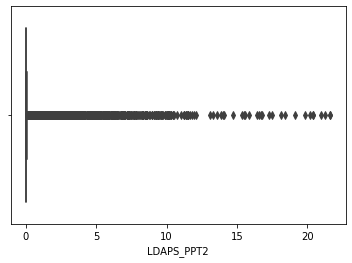

Box Plot forLDAPS_PPT3


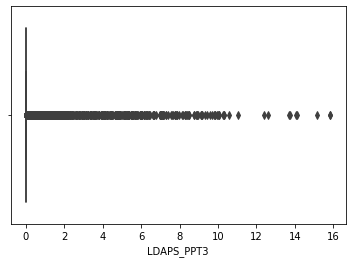

Box Plot forLDAPS_PPT4


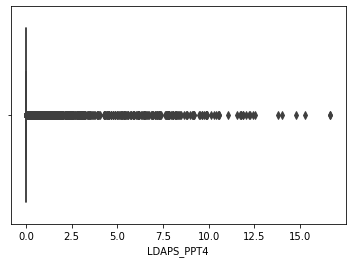

Box Plot forlat


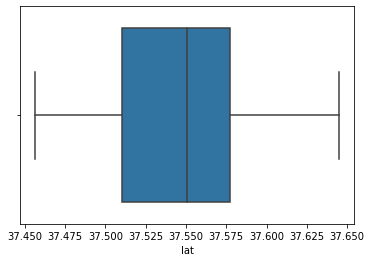

Box Plot forlon


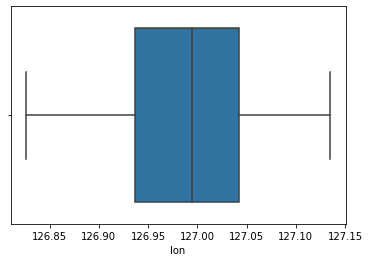

Box Plot forDEM


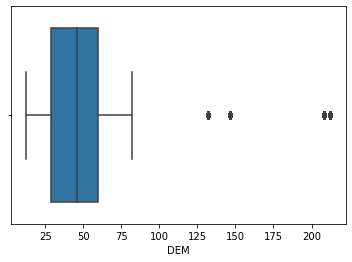

Box Plot forSlope


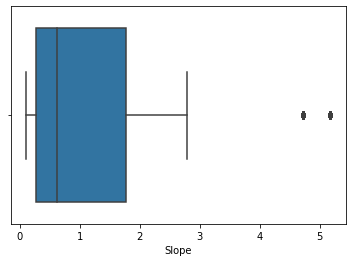

Box Plot forSolar radiation


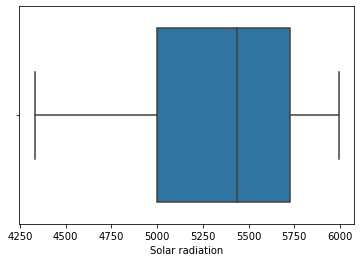

Box Plot forYear


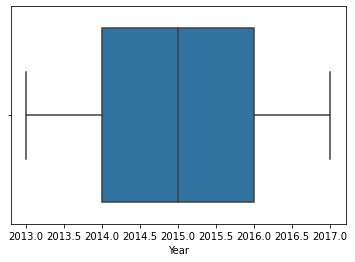

In [229]:
# Plot Box plot for all the numerical columns
for i in col:
    sns.boxplot(TF[i])
    print('Box Plot for'+i)
    plt.show()

Observation : 
    
Outliers are predsent in Present_Tmax,Present_Tmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,
LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,DEM,Slope    

### Bivariate Analysis

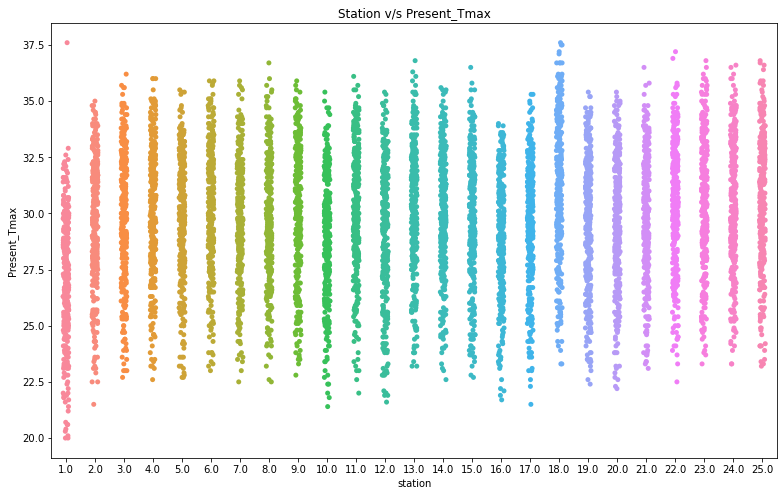

In [230]:
plt.figure(figsize=(13,8))
ax=sns.stripplot(TF['station'],TF['Present_Tmax'])
ax.set(xlabel='station',ylabel='Present_Tmax')
plt.title('Station v/s Present_Tmax')
plt.show()

Observation: 
    
Tmax is high for station 18 and lowest for station 1.

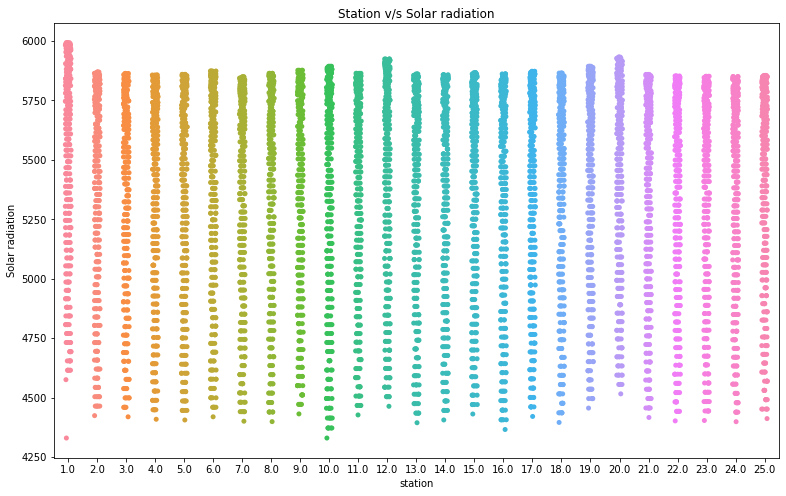

In [231]:
plt.figure(figsize=(13,8))
ax=sns.stripplot(TF['station'],TF['Solar radiation'])
ax.set(xlabel='station',ylabel='Solar radiation')
plt.title('Station v/s Solar radiation')
plt.show()

Observation : 
    
Solar radiation is highest for station no.1 .

Solar radiation is also high for station no 12 and 20.

Solar radiation is lowest for station 24 and 25.

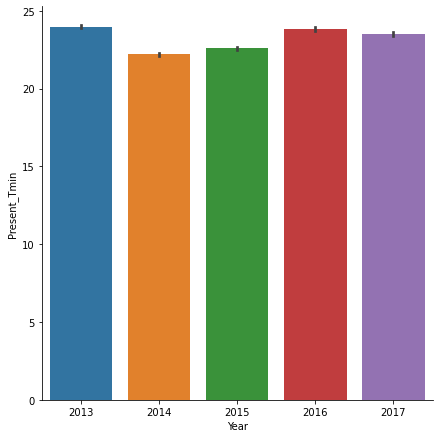

In [232]:
sns.catplot(x='Year',y='Present_Tmin',data=TF,kind='bar',size=6)
plt.show()

Observation:
    
Present_Tmin is high in year 2013 and lowest in year 2014.

<AxesSubplot:xlabel='Present_Tmax', ylabel='LDAPS_RHmin'>

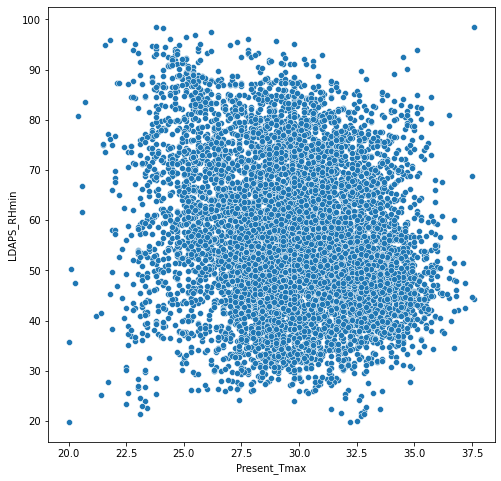

In [233]:
plt.figure(figsize=(8,8))
sns.scatterplot(x='Present_Tmax',y='LDAPS_RHmin',data=TF)

Observation:
    
LDAPS_RHmin and Present_Tmax are not correlated.    

<AxesSubplot:xlabel='Present_Tmin', ylabel='LDAPS_RHmin'>

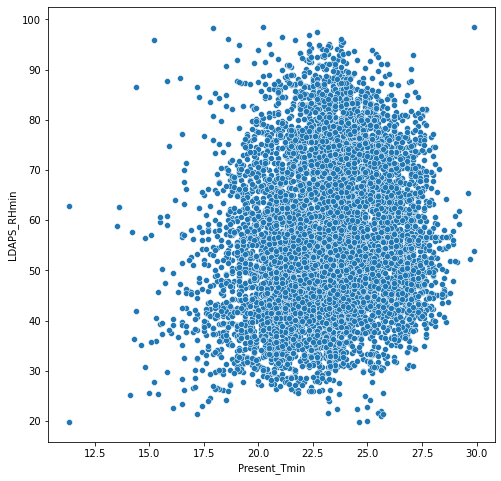

In [234]:
plt.figure(figsize=(8,8))
sns.scatterplot(x='Present_Tmin',y='LDAPS_RHmin',data=TF)

Observation:
    
LDAPS_RHmin and Present_Tmin are not correlated    

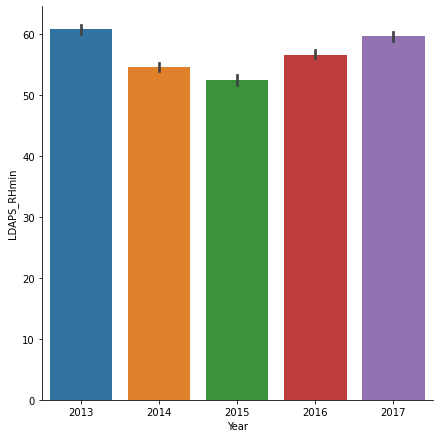

In [235]:
sns.catplot(x='Year',y='LDAPS_RHmin',data=TF,kind='bar',size=6)
plt.show()

Observation : 
    
LDAPS_RHmin is high in 2013 and redues till 2015 and again rises till 2017.    

### Multivariate Analysis

In [236]:
TF.head()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Year
0,1,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,0.0,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2,2013
1,2,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,0.159444,0.127727,0.0,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5,2013
2,3,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,0.204091,0.142125,0.0,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9,2013
3,4,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,0.161157,0.134249,0.0,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3,2013
4,5,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,0.178892,0.170021,0.0,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5,2013


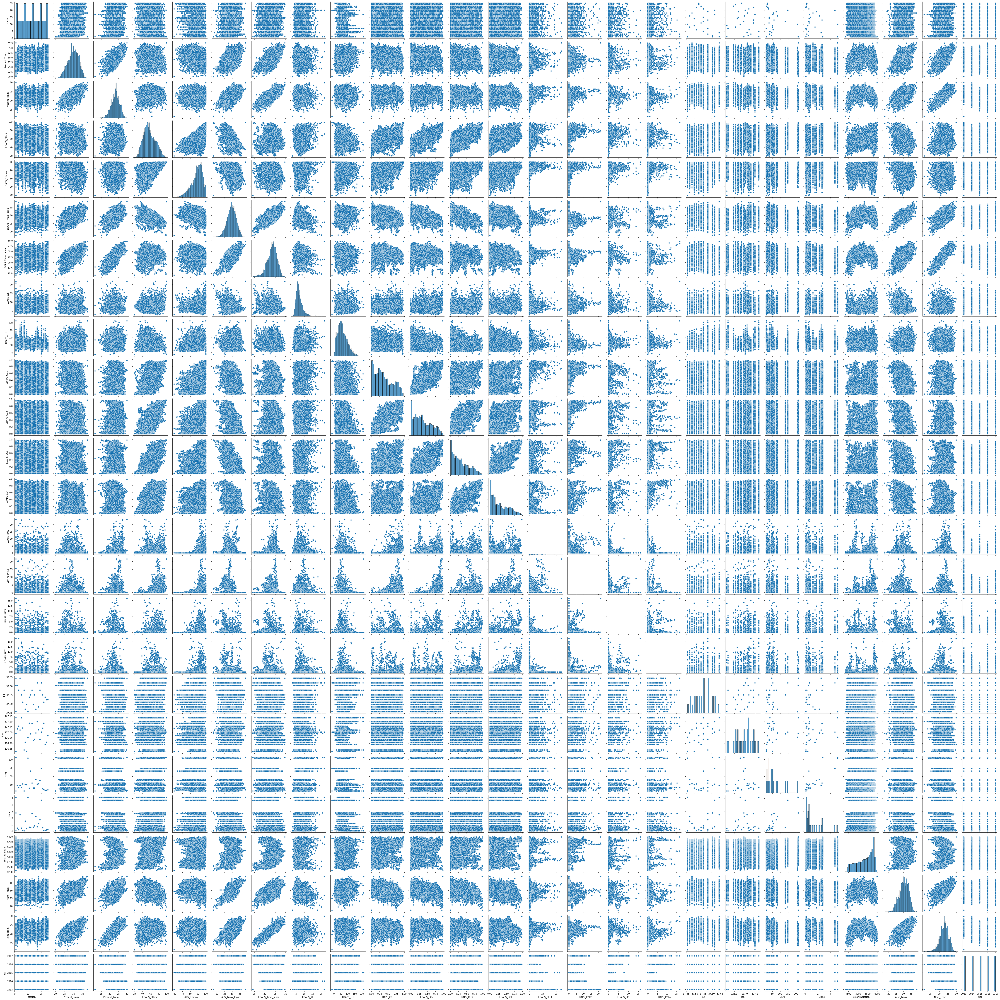

In [237]:
sns.pairplot(TF)

## Correlation

In [238]:
TF.corr()

,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Year
Present_Tmax,1.000000,0.618760,-0.204571,-0.301787,0.570129,0.623496,-0.121820,0.135463,-0.311805,-0.213791,-0.144018,-0.140729,-0.109006,-0.099449,-0.120367,-0.099607,-0.052615,0.009020,-0.187121,-0.105809,-0.025439,0.610348,0.622741,0.059904
Present_Tmin,0.618760,1.000000,0.123143,-0.015140,0.464151,0.762993,-0.034675,-0.009258,0.084447,0.090263,-0.002772,-0.044335,0.112845,0.068176,-0.046126,-0.062965,-0.078475,-0.043461,-0.250275,-0.146339,0.053578,0.471806,0.796670,0.037785
LDAPS_RHmin,-0.204571,0.123143,1.000000,0.579141,-0.564580,0.089476,0.294361,-0.070858,0.613818,0.745443,0.689679,0.514075,0.262665,0.390967,0.240642,0.168595,0.087099,-0.076237,0.102115,0.123744,0.244080,-0.437898,0.095019,-0.002104
LDAPS_RHmax,-0.301787,-0.015140,0.579141,1.000000,-0.373404,-0.114143,0.135333,0.238579,0.436652,0.391330,0.226957,0.130619,0.268449,0.229050,0.134607,0.117853,0.195798,0.025667,0.177168,0.219599,0.149261,-0.283738,-0.071997,-0.141341
LDAPS_Tmax_lapse,0.570129,0.464151,-0.564580,-0.373404,1.000000,0.654021,-0.311996,0.048010,-0.438439,-0.523619,-0.541327,-0.429539,-0.111065,-0.242122,-0.188115,-0.160273,-0.042093,0.090666,-0.178895,-0.162332,0.047971,0.827189,0.586868,0.016358
LDAPS_Tmin_lapse,0.623496,0.762993,0.089476,-0.114143,0.654021,1.000000,-0.130035,-0.134761,0.010901,0.047727,-0.044018,-0.080335,0.038056,0.000870,-0.088575,-0.094655,-0.096257,-0.026701,-0.195455,-0.185849,0.159975,0.586983,0.880176,-0.004447
LDAPS_WS,-0.121820,-0.034675,0.294361,0.135333,-0.311996,-0.130035,1.000000,0.006711,0.289445,0.261090,0.242991,0.220533,0.152587,0.191886,0.161684,0.144085,0.036657,-0.059466,0.191053,0.171629,0.121759,-0.342729,-0.096576,-0.112214
LDAPS_LH,0.135463,-0.009258,-0.070858,0.238579,0.048010,-0.134761,0.006711,1.000000,-0.147296,-0.264280,-0.245583,-0.172766,-0.012542,-0.077545,0.016102,0.019979,0.133221,0.025822,0.055133,0.086781,-0.047384,0.157616,-0.055440,0.056656
LDAPS_CC1,-0.311805,0.084447,0.613818,0.436652,-0.438439,0.010901,0.289445,-0.147296,1.000000,0.779683,0.517493,0.361046,0.446328,0.389453,0.168742,0.091722,-0.008131,-0.006843,-0.014090,-0.020752,0.218309,-0.452541,-0.011028,-0.066621
LDAPS_CC2,-0.213791,0.090263,0.745443,0.391330,-0.523619,0.047727,0.261090,-0.264280,0.779683,1.000000,0.725813,0.527708,0.305975,0.478472,0.240134,0.159548,-0.001497,-0.003581,-0.012823,-0.018073,0.170403,-0.490756,0.031250,-0.043427


#### Check heat map for better undersatnding of correlation.

<AxesSubplot:>

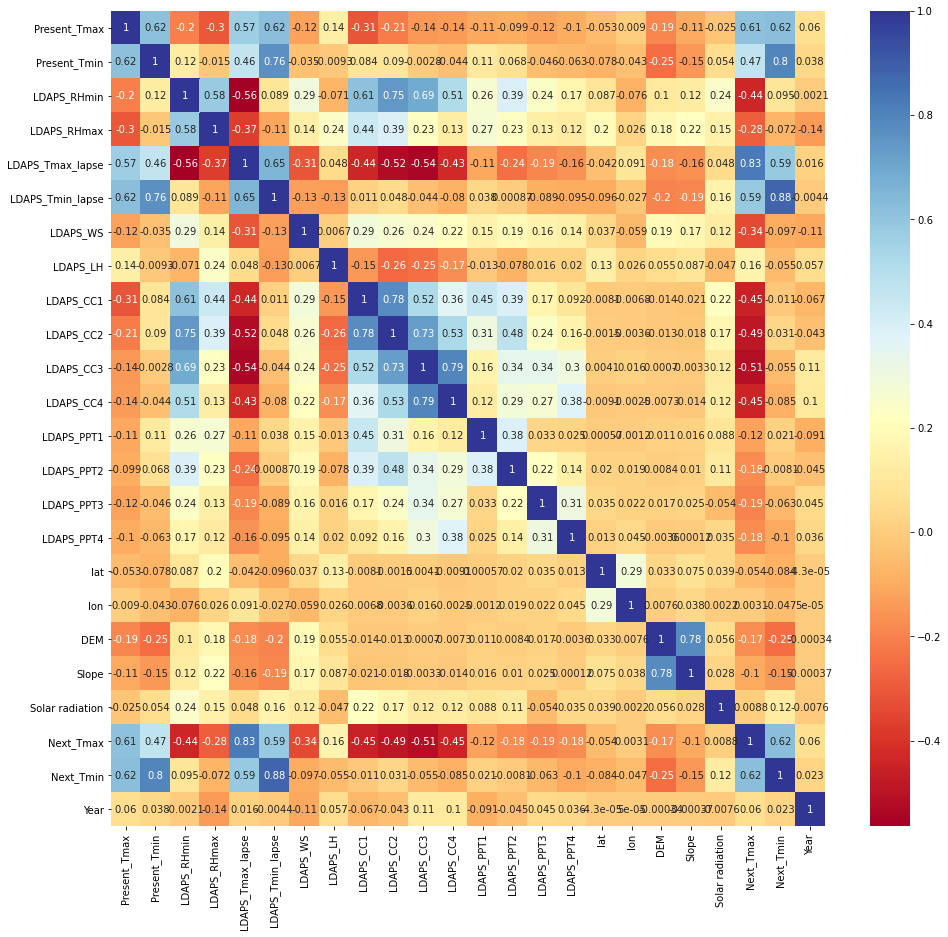

In [239]:
plt.figure(figsize=(16,15))
sns.heatmap(TF.corr(),annot=True,cmap='RdYlBu')

Observation:
    
Next_Tmin is highlr correlated with LDAPS_Tmin_lapse

Next_Tmin is highly correlated with Present_Tmin

LDAPS_Tmax_lapse is highlr correlated with LDAPS_CC2,LDAPS_CC3.

LDAPS_Tmax_lapse is highly correlated with Next_Tmax.

## Outliers

We will round off all the columns to max two decimals.

In [240]:
TF.round(2)

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Year
0,1,28.70,21.40,58.26,91.12,28.07,23.01,6.82,69.45,0.23,0.20,0.16,0.13,0.00,0.00,0.00,0.00,37.60,126.99,212.34,2.78,5992.90,29.10,21.20,2013
1,2,31.90,21.60,52.26,90.60,29.85,24.04,5.69,51.94,0.23,0.25,0.16,0.13,0.00,0.00,0.00,0.00,37.60,127.03,44.76,0.51,5869.31,30.50,22.50,2013
2,3,31.60,23.30,48.69,83.97,30.09,24.57,6.14,20.57,0.21,0.26,0.20,0.14,0.00,0.00,0.00,0.00,37.58,127.06,33.31,0.27,5863.56,31.10,23.90,2013
3,4,32.00,23.40,58.24,96.48,29.70,23.33,5.65,65.73,0.22,0.23,0.16,0.13,0.00,0.00,0.00,0.00,37.65,127.02,45.72,2.53,5856.96,31.70,24.30,2013
4,5,31.40,21.90,56.17,90.16,29.11,23.49,5.74,107.97,0.15,0.25,0.18,0.17,0.00,0.00,0.00,0.00,37.55,127.14,35.04,0.51,5859.55,31.20,22.50,2013
5,6,31.90,23.50,52.44,85.31,29.22,23.82,6.18,50.23,0.19,0.28,0.23,0.15,0.00,0.00,0.00,0.00,37.51,127.04,54.64,0.15,5873.78,31.50,24.00,2013
6,7,31.40,24.40,56.29,81.02,28.55,24.24,5.59,125.11,0.39,0.33,0.27,0.15,0.00,0.00,0.00,0.00,37.58,126.84,12.37,0.10,5849.23,30.90,23.40,2013
7,8,32.10,23.60,52.33,78.00,28.85,23.82,6.10,42.01,0.36,0.34,0.27,0.14,0.00,0.00,0.00,0.00,37.47,126.91,52.52,1.56,5863.99,31.10,22.90,2013
8,9,31.40,22.00,55.34,80.78,28.43,23.33,6.02,85.11,0.41,0.34,0.26,0.15,0.00,0.00,0.00,0.00,37.50,126.83,50.93,0.41,5876.90,31.30,21.60,2013
9,10,31.60,20.50,56.65,86.85,27.58,22.53,6.52,63.01,0.35,0.31,0.25,0.14,0.00,0.00,0.00,0.00,37.46,126.96,208.51,5.18,5893.61,30.50,21.00,2013


In [241]:
TF.describe()

,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Year
count,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000
mean,29.768211,23.225059,56.759372,88.374804,29.613447,23.512589,7.097875,62.505019,0.368774,0.356080,0.318404,0.299191,0.591995,0.485003,0.278200,0.269407,37.544722,126.991397,61.867972,1.257048,5341.502803,30.274887,22.932220,2014.999484
std,2.956557,2.403036,14.596973,7.157124,2.932898,2.333973,2.173245,33.567001,0.261185,0.256810,0.249148,0.253114,1.936331,1.754258,1.156174,1.200364,0.050352,0.079435,54.279780,1.370444,429.158867,3.122557,2.483276,1.414487
min,20.000000,11.300000,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,37.456200,126.826000,12.370000,0.098475,4329.520508,17.400000,11.300000,2013.000000
25%,27.800000,21.700000,46.046162,84.316923,27.693091,22.114651,5.686487,37.532764,0.148321,0.142328,0.103100,0.082741,0.000000,0.000000,0.000000,0.000000,37.510200,126.937000,28.700000,0.271300,4999.018555,28.200000,21.400000,2014.000000
50%,29.900000,23.400000,55.313244,89.699505,29.662273,23.735942,6.563068,57.310630,0.320110,0.315667,0.265264,0.232354,0.000000,0.000000,0.000000,0.000000,37.550700,126.995000,45.716000,0.618000,5436.345215,30.500000,23.100000,2015.000000
75%,32.000000,24.900000,67.038254,93.704500,31.683819,25.134000,8.007471,83.904586,0.571696,0.554963,0.494007,0.497230,0.067593,0.024276,0.009697,0.000693,37.577600,127.042000,59.832400,1.767800,5728.316406,32.600000,24.600000,2016.000000
max,37.600000,29.900000,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,0.967277,0.968353,0.983789,0.974710,23.701544,21.621661,15.841235,16.655469,37.645000,127.135000,212.335000,5.178230,5992.895996,38.900000,29.800000,2017.000000


Observation:
    
There is hige difference between 75% and max in columns LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4 and Slope.Leading to high possiblity of outliers.

In [242]:
TF.columns

Index(['station', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin', 'LDAPS_RHmax',
       'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS', 'LDAPS_LH',
       'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4', 'LDAPS_PPT1',
       'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon', 'DEM', 'Slope',
       'Solar radiation', 'Next_Tmax', 'Next_Tmin', 'Year'],
      dtype='object')

In [243]:
CN=['Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin', 'LDAPS_RHmax',
       'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS', 'LDAPS_LH',
       'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4', 'LDAPS_PPT1',
       'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon', 'DEM', 'Slope',
       'Solar radiation']

CN

['Present_Tmax',
 'Present_Tmin',
 'LDAPS_RHmin',
 'LDAPS_RHmax',
 'LDAPS_Tmax_lapse',
 'LDAPS_Tmin_lapse',
 'LDAPS_WS',
 'LDAPS_LH',
 'LDAPS_CC1',
 'LDAPS_CC2',
 'LDAPS_CC3',
 'LDAPS_CC4',
 'LDAPS_PPT1',
 'LDAPS_PPT2',
 'LDAPS_PPT3',
 'LDAPS_PPT4',
 'lat',
 'lon',
 'DEM',
 'Slope',
 'Solar radiation']

In [244]:
ncols,nrows = (10,3)

#### Box plot for outliers

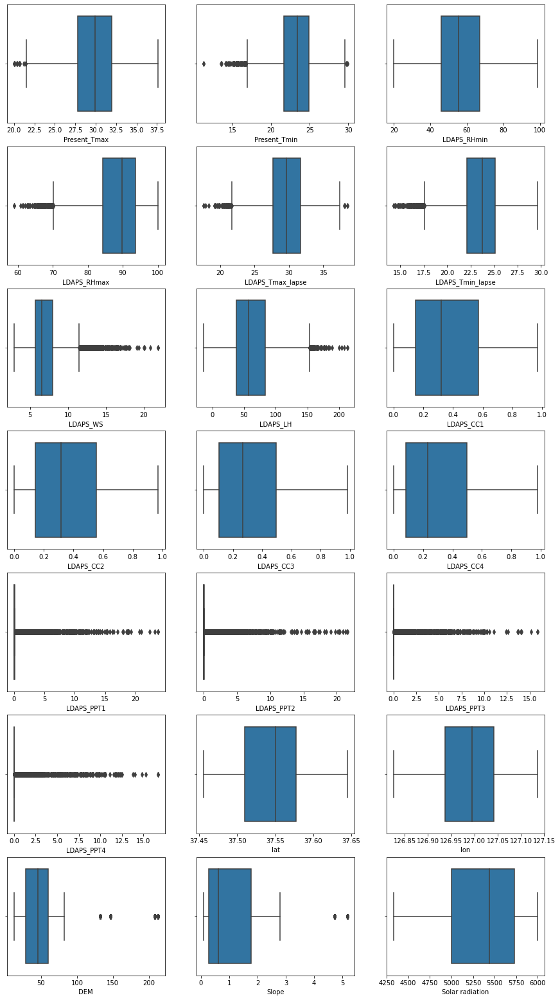

In [245]:
plt.figure(figsize=(15,40))
for index,col in enumerate(CN):
    plt.subplot(ncols,nrows,index+1)
    sns.boxplot(TF[CN[index]])

We will first treat the outliers by quantlie method (q4) for below mentioned columns.

In [246]:
Cq4=[ 'LDAPS_WS', 'LDAPS_PPT1','Present_Tmin','LDAPS_Tmax_lapse',
       'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'DEM', 'Slope',
    ]

Cq4

['LDAPS_WS',
 'LDAPS_PPT1',
 'Present_Tmin',
 'LDAPS_Tmax_lapse',
 'LDAPS_PPT2',
 'LDAPS_PPT3',
 'LDAPS_PPT4',
 'DEM',
 'Slope']

### Quantile

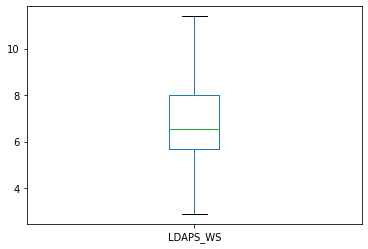

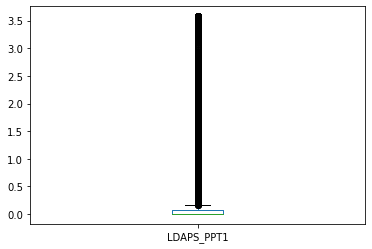

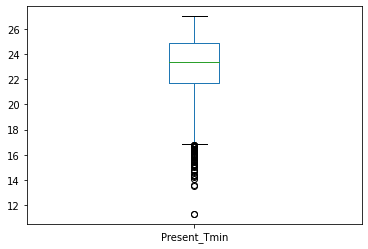

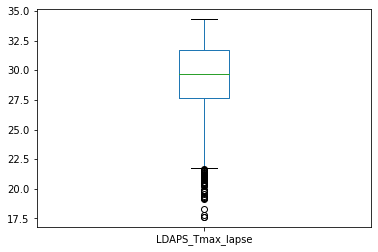

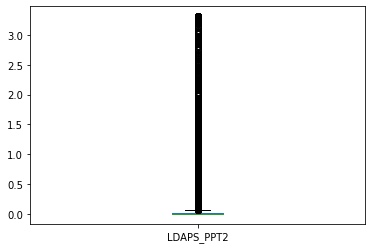

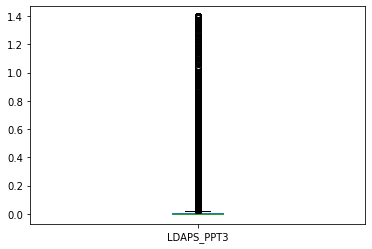

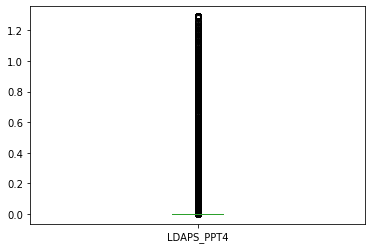

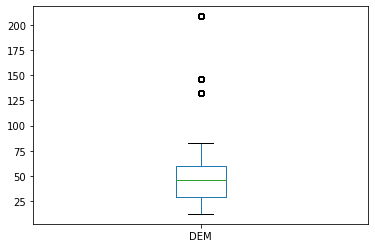

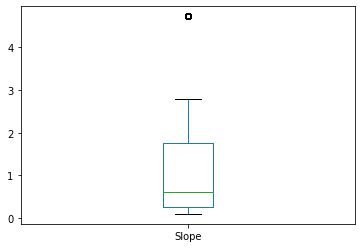

In [247]:
for i in Cq4:
    
    q4=TF[i].quantile(0.95)
    TF[i][TF[i]>q4]=q4
    TF[i].plot.box()
    plt.show()

We tried applying soft cappinf but still outliers are present ,we will try applying hard capping.

Apply soft capping for qarter 1 and for below mentioned columns. 

In [248]:
Cq1=['Present_Tmax', 'Present_Tmin', 'LDAPS_RHmax',
       'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse']

Cq1

['Present_Tmax',
 'Present_Tmin',
 'LDAPS_RHmax',
 'LDAPS_Tmax_lapse',
 'LDAPS_Tmin_lapse']

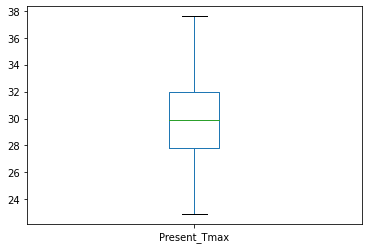

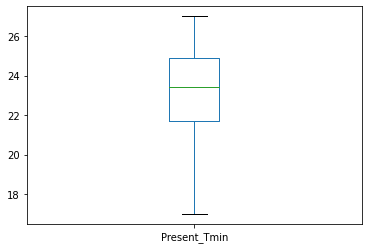

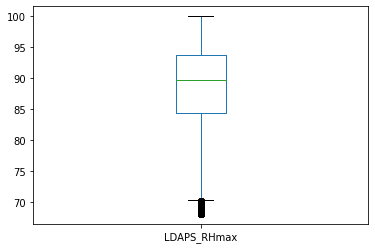

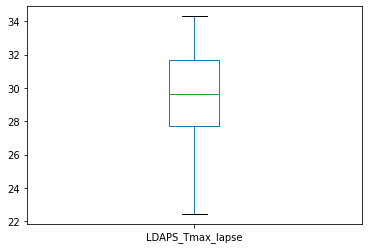

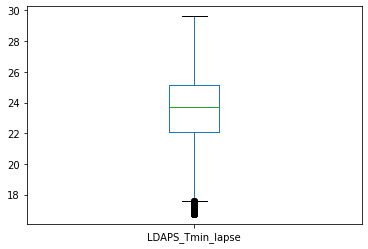

In [249]:
for i in Cq1:
    
    q1=TF[i].quantile(0.01)
    TF[i][TF[i]<q1]=q1
    TF[i].plot.box()
    plt.show()

We will drop columns 	LDAPS_PPT1	LDAPS_PPT2	LDAPS_PPT3	LDAPS_PPT4 as there are high number of outliers

In [250]:
TF.drop('LDAPS_PPT1',axis=1,inplace=True)

In [251]:
TF.drop('LDAPS_PPT2',axis=1,inplace=True)

In [252]:
TF.drop('LDAPS_PPT3',axis=1,inplace=True)

In [253]:
TF.drop('LDAPS_PPT4',axis=1,inplace=True)

## Data Spliting

In [254]:
TF.head(1)

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Year
0,1,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,37.6046,126.991,208.507,2.785,5992.895996,29.1,21.2,2013


In [255]:
y1=TF.iloc[:,19:20]

In [256]:
x1=TF.drop('Next_Tmin',axis=1)

In [257]:
x1.shape

(7752, 20)

In [258]:
y1.shape

(7752, 1)

In [259]:
y1.head(1)

,Next_Tmin
0,21.2


## Skewness

In [260]:
x1.head(1)

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Year
0,1,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,37.6046,126.991,208.507,2.785,5992.895996,29.1,2013


In [261]:
x1.skew()

station             0.000100
Present_Tmax       -0.223409
Present_Tmin       -0.372251
LDAPS_RHmin         0.300220
LDAPS_RHmax        -0.790843
LDAPS_Tmax_lapse   -0.286240
LDAPS_Tmin_lapse   -0.499077
LDAPS_WS            0.793076
LDAPS_LH            0.673757
LDAPS_CC1           0.459458
LDAPS_CC2           0.472350
LDAPS_CC3           0.640735
LDAPS_CC4           0.666482
lat                 0.087062
lon                -0.285213
DEM                 1.707550
Slope               1.465859
Solar radiation    -0.511210
Next_Tmax          -0.340200
Year                0.000365
dtype: float64

We will have to correct the skewness of  columns which are not within limit of -0.5 to 0.5.

In [262]:
x1['LDAPS_RHmax']=np.log(x1['LDAPS_RHmax'])
x1['LDAPS_RHmax'].skew()

-0.9844168507050854

In [263]:
from sklearn.preprocessing import PowerTransformer
pt=PowerTransformer(method='yeo-johnson',standardize=True) 
X_power=pt.fit_transform(x1.iloc[:,4:5])
x1.iloc[:,4:5]=pd.DataFrame(X_power,columns=x1.iloc[:,4:5].columns)
x1.iloc[:,4:5].skew()

LDAPS_RHmax   -0.120762
dtype: float64

In [264]:
from sklearn.preprocessing import PowerTransformer
pt=PowerTransformer(method='yeo-johnson',standardize=True) 
X_power=pt.fit_transform(x1.iloc[:,7:8])
x1.iloc[:,7:8]=pd.DataFrame(X_power,columns=x1.iloc[:,7:8].columns)
x1.iloc[:,7:8].skew()

LDAPS_WS    0.016129
dtype: float64

In [265]:
from sklearn.preprocessing import PowerTransformer
pt=PowerTransformer(method='yeo-johnson',standardize=True) 
X_power=pt.fit_transform(x1.iloc[:,8:9])
x1.iloc[:,8:9]=pd.DataFrame(X_power,columns=x1.iloc[:,8:9].columns)
x1.iloc[:,8:9].skew()

LDAPS_LH    0.057403
dtype: float64

In [266]:
from sklearn.preprocessing import PowerTransformer
pt=PowerTransformer(method='yeo-johnson',standardize=True) 
X_power=pt.fit_transform(x1.iloc[:,11:12])
x1.iloc[:,11:12]=pd.DataFrame(X_power,columns=x1.iloc[:,11:12].columns)
x1.iloc[:,11:12].skew()

LDAPS_CC3    0.087933
dtype: float64

In [267]:
from sklearn.preprocessing import PowerTransformer
pt=PowerTransformer(method='yeo-johnson',standardize=True) 
X_power=pt.fit_transform(x1.iloc[:,12:13])
x1.iloc[:,12:13]=pd.DataFrame(X_power,columns=x1.iloc[:,12:13].columns)
x1.iloc[:,12:13].skew()

LDAPS_CC4    0.126895
dtype: float64

In [268]:
from sklearn.preprocessing import PowerTransformer
pt=PowerTransformer(method='yeo-johnson',standardize=True) 
X_power=pt.fit_transform(x1.iloc[:,15:16])
x1.iloc[:,15:16]=pd.DataFrame(X_power,columns=x1.iloc[:,15:16].columns)
x1.iloc[:,15:16].skew()

DEM    0.039177
dtype: float64

In [269]:
from sklearn.preprocessing import PowerTransformer
pt=PowerTransformer(method='yeo-johnson',standardize=True) 
X_power=pt.fit_transform(x1.iloc[:,16:17])
x1.iloc[:,16:17]=pd.DataFrame(X_power,columns=x1.iloc[:,16:17].columns)
x1.iloc[:,16:17].skew()

Slope    0.229751
dtype: float64

In [270]:
x1.skew()

station             0.000100
Present_Tmax       -0.223409
Present_Tmin       -0.372251
LDAPS_RHmin         0.300220
LDAPS_RHmax        -0.120762
LDAPS_Tmax_lapse   -0.286240
LDAPS_Tmin_lapse   -0.499077
LDAPS_WS            0.016129
LDAPS_LH            0.057403
LDAPS_CC1           0.459458
LDAPS_CC2           0.472350
LDAPS_CC3           0.087933
LDAPS_CC4           0.126895
lat                 0.087062
lon                -0.285213
DEM                 0.039177
Slope               0.229751
Solar radiation    -0.511210
Next_Tmax          -0.340200
Year                0.000365
dtype: float64

Skewness of all columns is within limit

## Scaling

In [271]:
from sklearn.preprocessing import MinMaxScaler

In [272]:
scaler=MinMaxScaler()
x1=pd.DataFrame(scaler.fit_transform(x1),columns=x1.columns)

In [273]:
x1.head()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Year
0,0.000000,0.394558,0.44,0.488518,0.563975,0.475600,0.486517,0.678102,0.710832,0.241862,0.210559,0.296263,0.265438,0.786017,0.533981,1.000000,0.880339,1.000000,0.544186,0.0
1,0.041667,0.612245,0.46,0.412406,0.543475,0.625326,0.566352,0.549293,0.662788,0.233137,0.260000,0.292767,0.259870,0.786017,0.666667,0.535726,0.343043,0.925703,0.609302,0.0
2,0.083333,0.591837,0.63,0.367024,0.316465,0.645604,0.607557,0.604084,0.555724,0.216426,0.265884,0.359328,0.284606,0.643008,0.750809,0.425185,0.165754,0.922242,0.637209,0.0
3,0.125000,0.619048,0.64,0.488316,0.808267,0.613017,0.511308,0.543865,0.701059,0.223692,0.233388,0.295428,0.271172,1.000000,0.634304,0.543326,0.855257,0.918280,0.665116,0.0
4,0.166667,0.578231,0.49,0.462078,0.525836,0.563234,0.523756,0.554831,0.801947,0.156529,0.258165,0.322455,0.330348,0.500530,1.000000,0.444664,0.337883,0.919835,0.641860,0.0


#### Data is ready for model execution after treating the missing values,encoding,removing skewness and scaling

## Model Execution

In [274]:
maxAccu=0
maxRS=0

for i in range(1,100):
    x_train,x_test,y_train,y_test=train_test_split(x1,y1,test_size=.30,random_state=i)
    LR=LinearRegression()
    LR.fit(x_train,y_train)
    predl=LR.predict(x_test)
    ac=r2_score(y_test,predl)
    
    if ac>maxAccu:
        maxAccu=ac
        maxRS=i
        
print('Best r2_score at x is',maxAccu*100,'at random state',maxRS) 

Best r2_score at x is 85.66358418365563 at random state 84


## Linear Regresion

In [275]:
print('error')

print('Mean absolute error',mean_absolute_error(y_test,predl))
print('Mean squared error',mean_squared_error(y_test,predl))


print('Root mean squared error',np.sqrt(mean_squared_error(y_test,predl)))

error
Mean absolute error 0.7722676272959524
Mean squared error 0.9606114862760894
Root mean squared error 0.9801078952217911


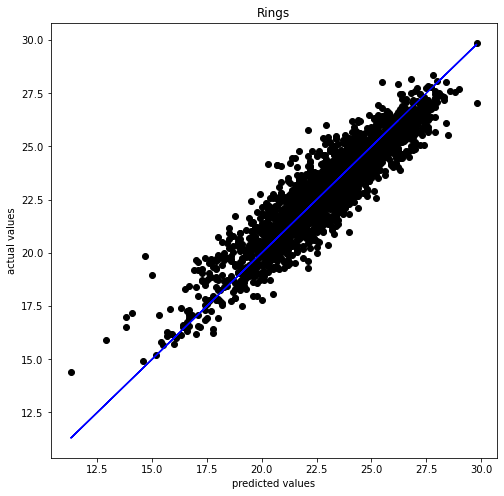

In [276]:
plt.figure(figsize=(8,8))
plt.scatter(x=y_test,y=predl,color='k')
plt.plot(y_test,y_test,color='b')
plt.xlabel('predicted values')
plt.ylabel('actual values')
plt.title('Rings')
plt.show()

### Hyper Parameter Tunning for Linear Regression Mode

In [277]:
from sklearn.model_selection import GridSearchCV

model =LinearRegression()
parameters = {'fit_intercept':[True,False], 'normalize':[True,False], 'copy_X':[True, False]}
grid = GridSearchCV(model,parameters, cv=5)
grid.fit(x_train,y_train)
grid.best_params_

{'copy_X': True, 'fit_intercept': True, 'normalize': True}

In [278]:
predx=grid.predict(x_test)
R2_score=r2_score(y_test,predx)
R2_score*100

84.55683348012829

R2_score for best parameters using linear regression model is 84.78%m

In [279]:
print('Error')

print('Mean absolute error',mean_absolute_error(y_test,predx))
print('Mean squared error',mean_squared_error(y_test,predx))


print('Root mean squared error',np.sqrt(mean_squared_error(y_test,predx)))

Error
Mean absolute error 0.7722676272959524
Mean squared error 0.9606114862760894
Root mean squared error 0.9801078952217911


Applying hyper parameter tunning for Linear Regression r2_score is 84.56%

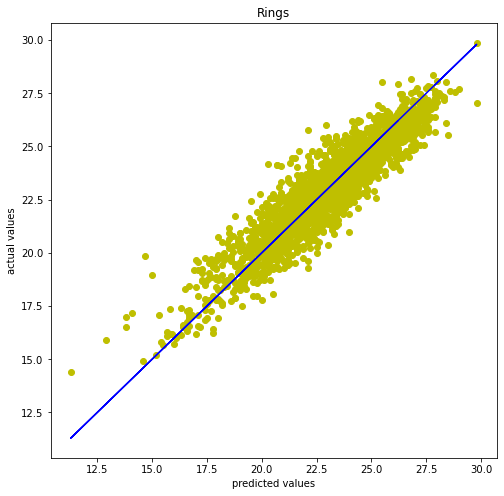

In [280]:
plt.figure(figsize=(8,8))
plt.scatter(x=y_test,y=predx,color='y')
plt.plot(y_test,y_test,color='b')
plt.xlabel('predicted values')
plt.ylabel('actual values')
plt.title('Rings')
plt.show()

## Random Forest Regressor

In [281]:
from sklearn.ensemble import RandomForestRegressor
rdr = RandomForestRegressor()
rdr.fit(x_train,y_train)
predrdr=rdr.predict(x_test)
print('The r2_score using ridge is:',r2_score(y_test,predrdr)*100)

The r2_score using ridge is: 90.48011744957714


In [282]:
print('error')

print('Mean absolute error',mean_absolute_error(y_test,predrdr))
print('Mean squared error',mean_squared_error(y_test,predrdr))


print('Root mean squared error',np.sqrt(mean_squared_error(y_test,predrdr)))

error
Mean absolute error 0.5748843558256602
Mean squared error 0.5921653771050238
Root mean squared error 0.7695228242911472


#### R2_score for random forest regressor model is 90.57% which is also better than linear regression models.

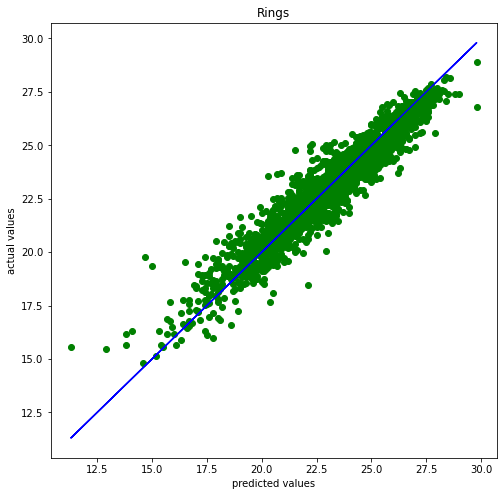

In [283]:
plt.figure(figsize=(8,8))
plt.scatter(x=y_test,y=predrdr,color='g')
plt.plot(y_test,y_test,color='b')
plt.xlabel('predicted values')
plt.ylabel('actual values')
plt.title('Rings')
plt.show()

### Hyperparameter Tunning for Random Forest Regressor

In [284]:
%%time
modelr =RandomForestRegressor()
parameters = {
    
    'max_depth': [ 50, 60, 70],
 'max_features': ['auto', 'sqrt'],
 'min_samples_leaf': [1, 2, 4],
             }

gridrfr = GridSearchCV(modelr,parameters,cv=3)
gridrfr.fit(x_train,y_train)
gridrfr.best_params_

Wall time: 1min 59s


{'max_depth': 50, 'max_features': 'sqrt', 'min_samples_leaf': 1}

In [285]:
predrfr=gridrfr.predict(x_test)
R2_score=r2_score(y_test,predrfr)
print('The R2_score for cv=7 is :',(R2_score*100))

The R2_score for cv=7 is : 91.30712083036154


#### After Hyper parameter tunning of random forest regressor our score has improved from 90.57 to 91.01%

In [286]:
print('Error')

print('Mean absolute error',mean_absolute_error(y_test,predrfr))
print('Mean squared error',mean_squared_error(y_test,predrfr))


print('Root mean squared error',np.sqrt(mean_squared_error(y_test,predrfr)))

Error
Mean absolute error 0.5506900950282022
Mean squared error 0.5407232751404808
Root mean squared error 0.7353388845562846


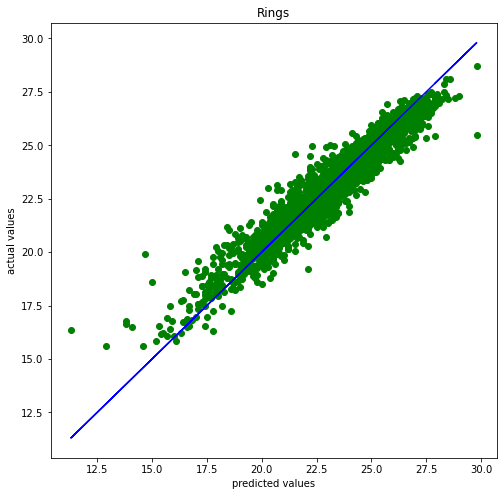

In [287]:
plt.figure(figsize=(8,8))
plt.scatter(x=y_test,y=predrfr,color='g')
plt.plot(y_test,y_test,color='b')
plt.xlabel('predicted values')
plt.ylabel('actual values')
plt.title('Rings')
plt.show()

## XGBoost Regressor Model

In [288]:
XGB = XGBRegressor()
XGB.fit(x_train,y_train)
pred_xgb=XGB.predict(x_test)
print('The r2_score using ridge is:',r2_score(y_test,pred_xgb)*100)

The r2_score using ridge is: 93.33294175954738


In [289]:
print('Error')

print('Mean absolute error',mean_absolute_error(y_test,pred_xgb))
print('Mean squared error',mean_squared_error(y_test,pred_xgb))
print('Root mean squared error',np.sqrt(mean_squared_error(y_test,pred_xgb)))

Error
Mean absolute error 0.48236857773690706
Mean squared error 0.41471110974614067
Root mean squared error 0.6439806749787921


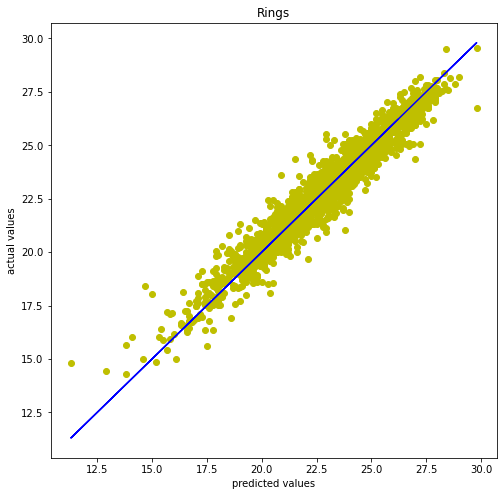

In [290]:
plt.figure(figsize=(8,8))
plt.scatter(x=y_test,y=pred_xgb,color='y')
plt.plot(y_test,y_test,color='b')
plt.xlabel('predicted values')
plt.ylabel('actual values')
plt.title('Rings')
plt.show()

### Hyperparameter Tunning for XGBoost Regressor

In [291]:
modelx =XGBRegressor()
parameters = {'max_depth':[1,4,6,10],'eta':[0.001,0.01,0.3,0.2],'subsample':[0.2,0.5,0.6]}
gridx = GridSearchCV(modelx,parameters,cv=5)
gridx.fit(x_train,y_train)
gridx.best_params_

{'eta': 0.2, 'max_depth': 6, 'subsample': 0.6}

In [292]:
predxg=gridx.predict(x_test)
R2_score=r2_score(y_test,predxg)
print('The R2_score for cv=3 is :',(R2_score*100))

The R2_score for cv=3 is : 93.11690967023809


##### After Hyper parameter tunning of random forest regressor our score has reduced from 93.33% to 93.11%

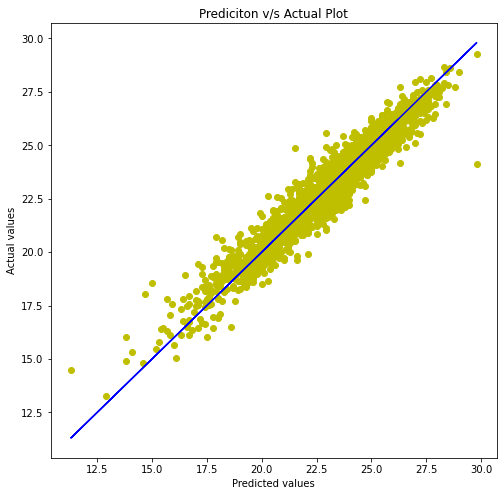

In [293]:
plt.figure(figsize=(8,8))
plt.scatter(x=y_test,y=predxg,color='y')
plt.plot(y_test,y_test,color='b')
plt.xlabel('Predicted values')
plt.ylabel('Actual values')
plt.title('Prediciton v/s Actual Plot')
plt.show()

In [294]:
print('error')

print('Mean absolute error',mean_absolute_error(y_test,predxg))
print('Mean squared error',mean_squared_error(y_test,predxg))
print('Root mean squared error',np.sqrt(mean_squared_error(y_test,predxg)))

error
Mean absolute error 0.48746007672767533
Mean squared error 0.4281489565845911
Root mean squared error 0.6543309228399581


### Conclusion : Next_Tmin: Next day  minimum temperature

#### After running the above models and hyper tunnnig each model we can conclude XgBoost regressor is best performing model with r2_score of 93.11% also root mean square error is less compared to all other models. 

Error

Mean absolute error 0.48746007672767533

Mean squared error 0.4281489565845911

Root mean squared error 0.6543309228399581

## Data Spliting

In [295]:
TF.head(1)

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Year
0,1,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,37.6046,126.991,208.507,2.785,5992.895996,29.1,21.2,2013


In [296]:
y2=TF.iloc[:,18:19]

In [297]:
x2=TF.drop('Next_Tmax',axis=1)

In [298]:
y2.head(2)

,Next_Tmax
0,29.1
1,30.5


## Skewness

In [299]:
x2.skew()

station             0.000100
Present_Tmax       -0.223409
Present_Tmin       -0.372251
LDAPS_RHmin         0.300220
LDAPS_RHmax        -0.790843
LDAPS_Tmax_lapse   -0.286240
LDAPS_Tmin_lapse   -0.499077
LDAPS_WS            0.793076
LDAPS_LH            0.673757
LDAPS_CC1           0.459458
LDAPS_CC2           0.472350
LDAPS_CC3           0.640735
LDAPS_CC4           0.666482
lat                 0.087062
lon                -0.285213
DEM                 1.707550
Slope               1.465859
Solar radiation    -0.511210
Next_Tmin          -0.404447
Year                0.000365
dtype: float64

We will have to correct the skewness of columns which are not within limit of -0.5 to 0.5

In [300]:
from sklearn.preprocessing import PowerTransformer
pt=PowerTransformer(method='yeo-johnson',standardize=True) 
X_power=pt.fit_transform(x2.iloc[:,4:5])
x2.iloc[:,4:5]=pd.DataFrame(X_power,columns=x2.iloc[:,4:5].columns)
x2.iloc[:,4:5].skew()

LDAPS_RHmax   -0.114788
dtype: float64

In [301]:
from sklearn.preprocessing import PowerTransformer
pt=PowerTransformer(method='yeo-johnson',standardize=True) 
X_power=pt.fit_transform(x2.iloc[:,7:8])
x2.iloc[:,7:8]=pd.DataFrame(X_power,columns=x2.iloc[:,7:8].columns)
x2.iloc[:,7:8].skew()

LDAPS_WS    0.016129
dtype: float64

In [302]:
from sklearn.preprocessing import PowerTransformer
pt=PowerTransformer(method='yeo-johnson',standardize=True) 
X_power=pt.fit_transform(x2.iloc[:,8:9])
x2.iloc[:,8:9]=pd.DataFrame(X_power,columns=x2.iloc[:,8:9].columns)
x2.iloc[:,8:9].skew()

LDAPS_LH    0.057403
dtype: float64

In [303]:
from sklearn.preprocessing import PowerTransformer
pt=PowerTransformer(method='yeo-johnson',standardize=True) 
X_power=pt.fit_transform(x2.iloc[:,11:12])
x2.iloc[:,11:12]=pd.DataFrame(X_power,columns=x2.iloc[:,11:12].columns)
x2.iloc[:,11:12].skew()

LDAPS_CC3    0.087933
dtype: float64

In [304]:
from sklearn.preprocessing import PowerTransformer
pt=PowerTransformer(method='yeo-johnson',standardize=True) 
X_power=pt.fit_transform(x2.iloc[:,12:13])
x2.iloc[:,12:13]=pd.DataFrame(X_power,columns=x2.iloc[:,12:13].columns)
x2.iloc[:,12:13].skew()

LDAPS_CC4    0.126895
dtype: float64

In [305]:
from sklearn.preprocessing import PowerTransformer
pt=PowerTransformer(method='yeo-johnson',standardize=True) 
X_power=pt.fit_transform(x2.iloc[:,15:16])
x2.iloc[:,15:16]=pd.DataFrame(X_power,columns=x2.iloc[:,15:16].columns)
x2.iloc[:,15:16].skew()

DEM    0.039177
dtype: float64

In [306]:
from sklearn.preprocessing import PowerTransformer
pt=PowerTransformer(method='yeo-johnson',standardize=True) 
X_power=pt.fit_transform(x2.iloc[:,16:17])
x2.iloc[:,16:17]=pd.DataFrame(X_power,columns=x2.iloc[:,16:17].columns)
x2.iloc[:,16:17].skew()

Slope    0.229751
dtype: float64

In [307]:
x2.skew()

station             0.000100
Present_Tmax       -0.223409
Present_Tmin       -0.372251
LDAPS_RHmin         0.300220
LDAPS_RHmax        -0.114788
LDAPS_Tmax_lapse   -0.286240
LDAPS_Tmin_lapse   -0.499077
LDAPS_WS            0.016129
LDAPS_LH            0.057403
LDAPS_CC1           0.459458
LDAPS_CC2           0.472350
LDAPS_CC3           0.087933
LDAPS_CC4           0.126895
lat                 0.087062
lon                -0.285213
DEM                 0.039177
Slope               0.229751
Solar radiation    -0.511210
Next_Tmin          -0.404447
Year                0.000365
dtype: float64

#### Skewness of all the columns is within the limit

## Scaling

In [308]:
from sklearn.preprocessing import MinMaxScaler

In [309]:
scaler=MinMaxScaler()
x2=pd.DataFrame(scaler.fit_transform(x2),columns=x2.columns)

In [310]:
x2.head()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,lat,lon,DEM,Slope,Solar radiation,Next_Tmin,Year
0,0.000000,0.394558,0.44,0.488518,0.562384,0.475600,0.486517,0.678102,0.710832,0.241862,0.210559,0.296263,0.265438,0.786017,0.533981,1.000000,0.880339,1.000000,0.535135,0.0
1,0.041667,0.612245,0.46,0.412406,0.541934,0.625326,0.566352,0.549293,0.662788,0.233137,0.260000,0.292767,0.259870,0.786017,0.666667,0.535726,0.343043,0.925703,0.605405,0.0
2,0.083333,0.591837,0.63,0.367024,0.316010,0.645604,0.607557,0.604084,0.555724,0.216426,0.265884,0.359328,0.284606,0.643008,0.750809,0.425185,0.165754,0.922242,0.681081,0.0
3,0.125000,0.619048,0.64,0.488316,0.806903,0.613017,0.511308,0.543865,0.701059,0.223692,0.233388,0.295428,0.271172,1.000000,0.634304,0.543326,0.855257,0.918280,0.702703,0.0
4,0.166667,0.578231,0.49,0.462078,0.524347,0.563234,0.523756,0.554831,0.801947,0.156529,0.258165,0.322455,0.330348,0.500530,1.000000,0.444664,0.337883,0.919835,0.605405,0.0


#### Data is ready for execution after treating the missing values,removing skewnwss and scaling.

## MODEL EXECUTION

In [311]:
maxAccu=0
maxRS=0

for i in range(1,100):
    x_train,x_test,y_train,y_test=train_test_split(x2,y2,test_size=.30,random_state=i)
    LR=LinearRegression()
    LR.fit(x_train,y_train)
    predl=LR.predict(x_test)
    ac=r2_score(y_test,predl)
    
    if ac>maxAccu:
        maxAccu=ac
        maxRS=i
        
print('Best r2_score at x is',maxAccu*100,'at random state',maxRS) 

Best r2_score at x is 79.86267111738697 at random state 4


## Linear Regresion

In [312]:
print('error')

print('Mean absolute error',mean_absolute_error(y_test,predl))
print('Mean squared error',mean_squared_error(y_test,predl))


print('Root mean squared error',np.sqrt(mean_squared_error(y_test,predl)))

error
Mean absolute error 1.1116787406734665
Mean squared error 2.1700881945909765
Root mean squared error 1.4731219211562145


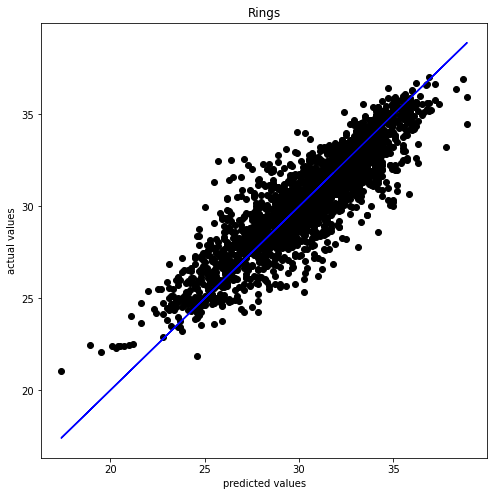

In [313]:
plt.figure(figsize=(8,8))
plt.scatter(x=y_test,y=predl,color='k')
plt.plot(y_test,y_test,color='b')
plt.xlabel('predicted values')
plt.ylabel('actual values')
plt.title('Rings')
plt.show()

### Hyper Parameter Tunning for Linear Regression Model

In [314]:
from sklearn.model_selection import GridSearchCV

model =LinearRegression()
parameters = {'fit_intercept':[True,False], 'normalize':[True,False], 'copy_X':[True, False]}
grid = GridSearchCV(model,parameters, cv=5)
grid.fit(x_train,y_train)
grid.best_params_

{'copy_X': True, 'fit_intercept': True, 'normalize': True}

In [315]:
predx=grid.predict(x_test)
R2_score=r2_score(y_test,predx)
R2_score*100

77.62187921674038

In [316]:
print('Error')

print('Mean absolute error',mean_absolute_error(y_test,predx))
print('Mean squared error',mean_squared_error(y_test,predx))


print('Root mean squared error',np.sqrt(mean_squared_error(y_test,predx)))

Error
Mean absolute error 1.1116787406734665
Mean squared error 2.170088194590977
Root mean squared error 1.4731219211562148


#### Applying hyper parameter tunning for Linear Regression r2_score is 77.62%.

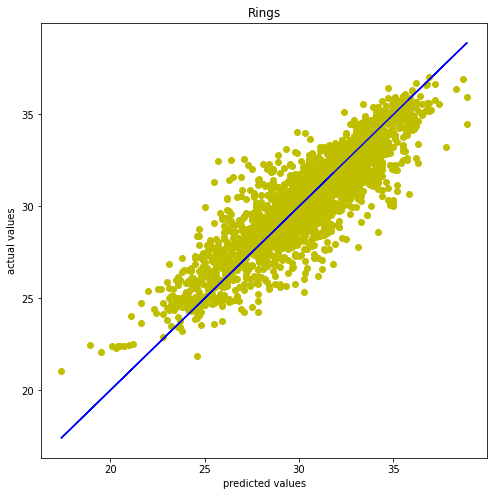

In [317]:
plt.figure(figsize=(8,8))
plt.scatter(x=y_test,y=predx,color='y')
plt.plot(y_test,y_test,color='b')
plt.xlabel('predicted values')
plt.ylabel('actual values')
plt.title('Rings')
plt.show()

## Random Forest Regressor

In [318]:
from sklearn.ensemble import RandomForestRegressor
rdr = RandomForestRegressor()
rdr.fit(x_train,y_train)
predrdr=rdr.predict(x_test)
print('The r2_score using ridge is:',r2_score(y_test,predrdr)*100)

The r2_score using ridge is: 89.0615248331495


In [319]:
print('error')

print('Mean absolute error',mean_absolute_error(y_test,predrdr))
print('Mean squared error',mean_squared_error(y_test,predrdr))


print('Root mean squared error',np.sqrt(mean_squared_error(y_test,predrdr)))

error
Mean absolute error 0.7511566443218217
Mean squared error 1.0607439318213927
Root mean squared error 1.029924235961749


#### R2_score for random forest regressor model is 89.28% which is also better than linear regression models.

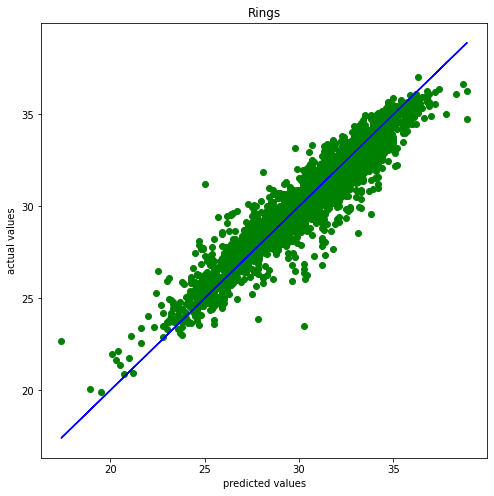

In [320]:
plt.figure(figsize=(8,8))
plt.scatter(x=y_test,y=predrdr,color='g')
plt.plot(y_test,y_test,color='b')
plt.xlabel('predicted values')
plt.ylabel('actual values')
plt.title('Rings')
plt.show()

### Hyperparameter Tunning for Random Forest Regressor

In [321]:
%%time
modelr =RandomForestRegressor()
parameters = {
    
    'max_depth': [ 50, 60, 70],
 'max_features': ['auto', 'sqrt'],
 'min_samples_leaf': [1, 2, 4]
             }

gridrfr = GridSearchCV(modelr,parameters,cv=5)
gridrfr.fit(x_train,y_train)
gridrfr.best_params_

Wall time: 3min 23s


{'max_depth': 60, 'max_features': 'sqrt', 'min_samples_leaf': 1}

In [322]:
predrfr=gridrfr.predict(x_test)
R2_score=r2_score(y_test,predrfr)
print('The R2_score for cv=7 is :',(R2_score*100))

The R2_score for cv=7 is : 89.80272965694138


#### After Hyper parameter tunning of random forest regressor our score has improved from 89.28 to 89.84%

In [323]:
print('Error')

print('Mean absolute error',mean_absolute_error(y_test,predrfr))
print('Mean squared error',mean_squared_error(y_test,predrfr))


print('Root mean squared error',np.sqrt(mean_squared_error(y_test,predrfr)))

Error
Mean absolute error 0.7314782954472725
Mean squared error 0.9888665899541574
Root mean squared error 0.9944177140186902


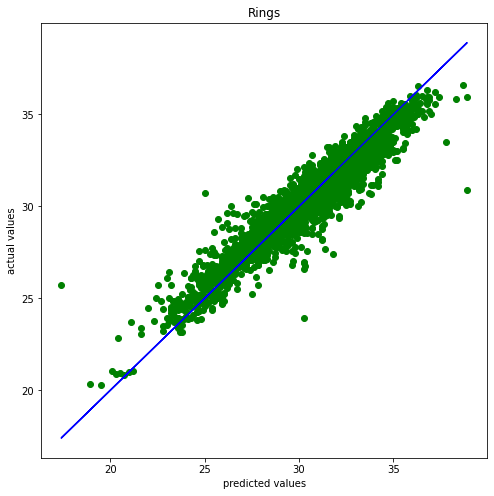

In [324]:
plt.figure(figsize=(8,8))
plt.scatter(x=y_test,y=predrfr,color='g')
plt.plot(y_test,y_test,color='b')
plt.xlabel('predicted values')
plt.ylabel('actual values')
plt.title('Rings')
plt.show()

## XGBoost Regressor Model

In [325]:
XGB = XGBRegressor()
XGB.fit(x_train,y_train)
pred_xgb=XGB.predict(x_test)
print('The r2_score using ridge is:',r2_score(y_test,pred_xgb)*100)

The r2_score using ridge is: 91.07444395277535


R2_score for XGBoost regressor model is 91.07% which is also better than other models

In [326]:
print('Error')

print('Mean absolute error',mean_absolute_error(y_test,pred_xgb))
print('Mean squared error',mean_squared_error(y_test,pred_xgb))
print('Root mean squared error',np.sqrt(mean_squared_error(y_test,pred_xgb)))

Error
Mean absolute error 0.681955518959117
Mean squared error 0.8655438048547776
Root mean squared error 0.9303460672538889


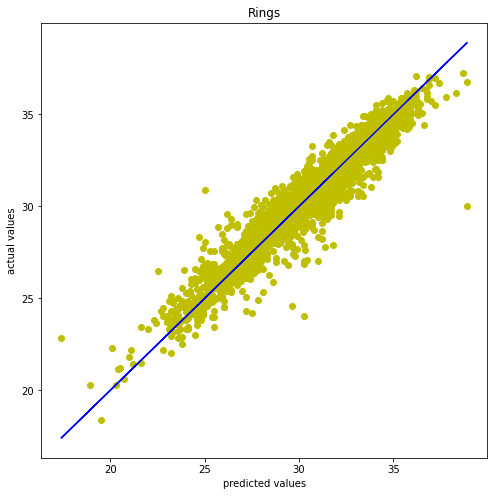

In [327]:
plt.figure(figsize=(8,8))
plt.scatter(x=y_test,y=pred_xgb,color='y')
plt.plot(y_test,y_test,color='b')
plt.xlabel('predicted values')
plt.ylabel('actual values')
plt.title('Rings')
plt.show()

#### Hyperparameter Tunning for XGBoost Regressor

In [328]:
modelx =XGBRegressor()
parameters = {'max_depth':[1,4,6,10],'eta':[0.001,0.01,0.3,0.2],'subsample':[0.2,0.5,0.6]}
gridxg = GridSearchCV(modelx,parameters,cv=3)
gridxg.fit(x_train,y_train)
gridxg.best_params_

{'eta': 0.2, 'max_depth': 6, 'subsample': 0.6}

In [329]:
predxgb=gridxg.predict(x_test)
R2_score=r2_score(y_test,predxgb)
print('The R2_score for cv=3 is :',(R2_score*100))

The R2_score for cv=3 is : 90.76836255387568


#### After Hyper parameter tunning of random forest regressor our score has reduced from 91.07 to 90.76%

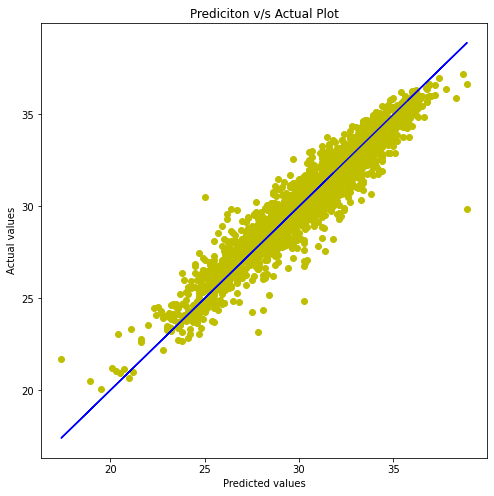

In [330]:
plt.figure(figsize=(8,8))
plt.scatter(x=y_test,y=predxgb,color='y')
plt.plot(y_test,y_test,color='b')
plt.xlabel('Predicted values')
plt.ylabel('Actual values')
plt.title('Prediciton v/s Actual Plot')
plt.show()

In [331]:
print('error')

print('Mean absolute error',mean_absolute_error(y_test,predxg))
print('Mean squared error',mean_squared_error(y_test,predxg))
print('Root mean squared error',np.sqrt(mean_squared_error(y_test,predxg)))

error
Mean absolute error 7.368803845900274
Mean squared error 60.17882499214695
Root mean squared error 7.757501208001643


## Conclusion : Next_Tmax: Next day maximum temperature

#### After running the above models and hyper tunnnig each model we can conclude XgBoost regressor is best performing model with r2_score of 90.176% also root mean square error is less compared to all other models

Error:
    
Mean absolute error 0.6969931971143355

Mean squared error 0.8952256372467524

Root mean squared error 0.9461636418964493

## JOBLIB

### FOR Next_Tmin

In [332]:
joblib.dump(gridx,'TF.obj')

['TF.obj']

### FOR Next_Tmax

In [333]:
joblib.dump(gridxg,'TF.obj')

['TF.obj']